In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import numpy as np
import os
import random
import torchvision.transforms as T
from glob import glob

In [7]:
# --- Set seeds for reproducibility ---
torch.manual_seed(0)
np.random.seed(0)
random.seed(0)

In [3]:
import sys
print(sys.executable)

/rds/general/user/mb1024/home/myenv/bin/python


In [8]:
class InMemoryContrastiveDataset(Dataset):
    def __init__(self, array_stack, transform=None):
        self.data = array_stack
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        arr = self.data[idx].astype(np.float32)
        if np.std(arr) == 0:
            arr += np.random.normal(0, 1e-6, size=arr.shape)
        arr = (arr - arr.min()) / (arr.max() - arr.min() + 1e-8)
        arr = np.expand_dims(arr, axis=0)  # [1, H, W]
        img = torch.from_numpy(arr)

        if self.transform:
            return self.transform(img)
        return img, img


In [9]:
# initial CNN model placeholder
class simple_cnn(nn.Module):
    def __init__(self):
        super().__init__()
        self.c1 = nn.Conv2d(1, 32, kernel_size=3, stride=1, padding=1)
        self.p1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.c2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.p2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.c3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        self.p3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.act = nn.ReLU()
        self.avg = nn.AdaptiveAvgPool2d((1, 1))



    def forward(self, x):
        x = self.act(self.c1(x))
        x = self.p1(x)
        x = self.act(self.c2(x))
        x = self.p2(x)
        x = self.act(self.c3(x))
        x = self.p3(x)
        x = self.avg(x)
        return x.view(x.size(0), -1)

In [10]:
import torch.nn as nn

class simple_cnn(nn.Module):
    def __init__(self):
        super().__init__()
        self.c1 = nn.Conv2d(1, 32, kernel_size=3, stride=1, padding=1)
        self.b1 = nn.BatchNorm2d(32)

        self.c2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.b2 = nn.BatchNorm2d(64)

        self.c3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        self.b3 = nn.BatchNorm2d(128)

        self.c4 = nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1)
        self.b4 = nn.BatchNorm2d(256)

        self.c5 = nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=1)  # New layer
        self.b5 = nn.BatchNorm2d(512)

        self.act = nn.ReLU()

        self.p = nn.MaxPool2d(kernel_size=2, stride=2)

        self.avg = nn.AdaptiveAvgPool2d((1, 1))

    def forward(self, x):
        x = self.p(self.act(self.b1(self.c1(x))))
        x = self.p(self.act(self.b2(self.c2(x))))
        x = self.p(self.act(self.b3(self.c3(x))))
        x = self.p(self.act(self.b4(self.c4(x))))
        x = self.p(self.act(self.b5(self.c5(x))))
        x = self.avg(x)
        return x.view(x.size(0), -1)  # Final embedding vector


In [6]:
import torch
import torch.nn as nn

class simple_cnn(nn.Module):
    def __init__(self):
        super().__init__()

        self.c1 = nn.Conv2d(1, 32, kernel_size=3, padding=1)
        self.b1 = nn.BatchNorm2d(32)

        self.c2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.b2 = nn.BatchNorm2d(64)

        self.c3 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.b3 = nn.BatchNorm2d(128)

        # Bottleneck Block
        self.bneck1 = nn.Conv2d(128, 64, kernel_size=1)      # Reduce channels
        self.bneck2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)  # Process
        self.bneck3 = nn.Conv2d(64, 128, kernel_size=1)      # Restore channels
        self.bneck_bn = nn.BatchNorm2d(128)
        self.bneck_act = nn.ReLU()

        self.c4 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.b4 = nn.BatchNorm2d(256)

        self.c5 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.b5 = nn.BatchNorm2d(512)

        self.act = nn.ReLU()
        self.p = nn.MaxPool2d(kernel_size=2, stride=2)
        self.avg = nn.AdaptiveAvgPool2d((1, 1))

    def forward(self, x):
        x = self.p(self.act(self.b1(self.c1(x))))
        x = self.p(self.act(self.b2(self.c2(x))))
        x = self.p(self.act(self.b3(self.c3(x))))

        # Bottleneck block
        identity = x
        x = self.bneck1(x)
        x = self.bneck_act(x)
        x = self.bneck2(x)
        x = self.bneck_act(x)
        x = self.bneck3(x)
        x = self.bneck_bn(x)
        x += identity              # Residual connection
        x = self.bneck_act(x)
        x = self.p(x)

        x = self.p(self.act(self.b4(self.c4(x))))
        x = self.p(self.act(self.b5(self.c5(x))))
        x = self.avg(x)
        return x.view(x.size(0), -1)


In [35]:
# Data augmentation placeholder
class contrastive_transforms:
    def __init__(self):
        self.transform = T.Compose([
        T.RandomResizedCrop(190, scale=(0.5, 1.0)),
        T.RandomHorizontalFlip(),
        T.RandomVerticalFlip(),
        T.GaussianBlur(kernel_size=3, sigma=(0.1, 2.0))
        #T.RandomApply([T.RandomAffine(degrees=15, translate=(0.05, 0.05))], p=0.5)
])

    def __call__(self, x):   # calls the funtion when an instance of the class is called
        return self.transform(x), self.transform(x)

In [12]:
folder = "/rds/general/user/mb1024/home/sigma0_arrays"
npy_files = sorted(glob(os.path.join(folder, "*.npy")))

# Load arrays
sigma0_arrays = [np.load(f) for f in npy_files]

In [ ]:
print(sigma0_arrays[0])

In [ ]:
# print length of array 
print(len(sigma0_arrays))

In [ ]:
clean_sigma0_arrays = []

for arr in sigma0_arrays:
    nan_ratio = np.isnan(arr).sum() / arr.size

    if nan_ratio < 0.3:
        mean_val = np.nanmean(arr)

        # Fix: handle case where mean is still nan
        if np.isnan(mean_val):
            continue  # skip this array entirely

        arr_filled = np.where(np.isnan(arr), mean_val, arr)
        clean_sigma0_arrays.append(arr_filled)

In [15]:
print(len(sigma0_arrays))

4454


In [ ]:
from scipy.ndimage import generic_filter

def fill_nan_with_local_mean(array):
    def filter_func(values):
        center = values[len(values) // 2]
        return np.nanmean(values) if np.isnan(center) else center

    return generic_filter(array, filter_func, size=3, mode='mirror')

clean_sigma0_arrays = []
for arr in sigma0_arrays:
    cleaned = fill_nan_with_local_mean(arr)
    clean_sigma0_arrays.append(cleaned)

In [13]:
import numpy as np
from scipy.ndimage import convolve

kernel = np.ones((3, 3))
kernel[1, 1] = 0  # exclude center pixel if you want

def fast_local_mean_fill(arr):
    nan_mask = np.isnan(arr)
    arr_copy = arr.copy()
    arr_copy[nan_mask] = 0

    local_sum = convolve(arr_copy, kernel, mode='mirror')
    local_count = convolve(~nan_mask, kernel, mode='mirror')  # count non-nans

    filled_values = np.where(local_count > 0, local_sum / local_count, np.nan)
    return np.where(nan_mask, filled_values, arr)

# Apply without loop using list comprehension (still parallelizable)
clean_sigma0_arrays = [fast_local_mean_fill(arr) for arr in sigma0_arrays]


In [14]:
print(len(clean_sigma0_arrays))

5004


In [7]:

nan_counts = [np.isnan(arr).sum() for arr in clean_sigma0_arrays]
total_with_nans = sum(count > 0 for count in nan_counts)

print(f"Arrays with remaining NaNs: {total_with_nans}")


Arrays with remaining NaNs: 0


In [ ]:
print(clean_sigma0_arrays[13])

In [15]:
# Find smallest height and width
# Can be changed to padded however all arrays are similar size
min_height = min(arr.shape[0] for arr in clean_sigma0_arrays)
min_width = min(arr.shape[0] for arr in clean_sigma0_arrays)

In [16]:


# Crop arrays to smallest shape
cropped_arrays = [arr[:min_height, :min_width] for arr in clean_sigma0_arrays]
# Print shapes of cropped arrays
#for i, arr in enumerate(cropped_arrays):
 #   print(f"Shape of cropped array {i}: {arr.shape}")
# remove cropped_arrays not in 2D shape
cropped_arrays = [arr for arr in cropped_arrays if arr.ndim == 2]
# Print final cropped arrays shape
print(f"Final cropped arrays shape: {len(cropped_arrays)} arrays, each of shape {cropped_arrays[0].shape if cropped_arrays else 'N/A'}")

# Now stack
sigma0_stack = np.stack(cropped_arrays)

Final cropped arrays shape: 5004 arrays, each of shape (190, 190)


In [36]:
# --- Load Custom Dataset ---
train_dataset = InMemoryContrastiveDataset(sigma0_stack, transform=contrastive_transforms())
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=2, drop_last=True)

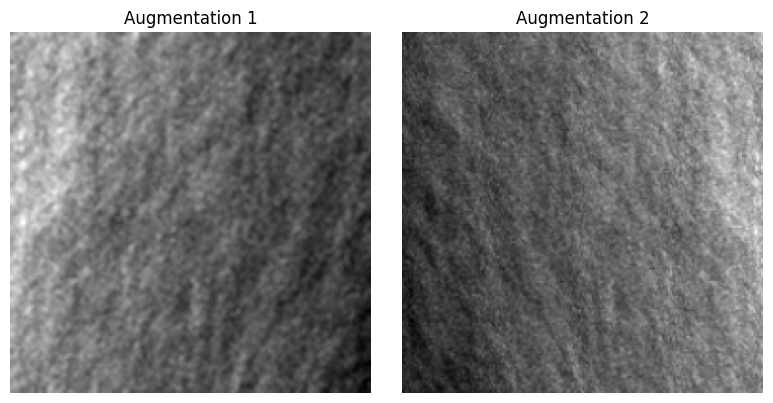

In [37]:
import matplotlib.pyplot as plt

# Get a single pair of augmentations from the dataset
augmented_1, augmented_2 = train_dataset[890]  # or any other index

# Convert from torch tensors to numpy arrays
img1 = augmented_1.squeeze().numpy()  # shape: [H, W]
img2 = augmented_2.squeeze().numpy()

# Plot side by side
fig, axs = plt.subplots(1, 2, figsize=(8, 4))
axs[0].imshow(img1, cmap='gray')
axs[0].set_title('Augmentation 1')
axs[0].axis('off')

axs[1].imshow(img2, cmap='gray')
axs[1].set_title('Augmentation 2')
axs[1].axis('off')

plt.tight_layout()
plt.show()


In [18]:
# Initial SimCLR model placeholder
class SimCLR(nn.Module):
    def __init__(self, base_encoder, out_dim=512):
        super().__init__()
        self.encoder = base_encoder
        self.projector = nn.Sequential(
            nn.Linear(512, 512),
            nn.ReLU(),
            nn.Linear(512, 512)
        )

    def forward(self, x):
        h = self.encoder(x)
        z = self.projector(h)
        z = F.normalize(z, dim=1, eps=1e-8)
        return z

In [19]:
def nt_xent_loss(z_i, z_j, temperature=0.5):
    batch_size = z_i.size(0)
    z = torch.cat([z_i, z_j], dim=0)  # [2B, D]
    z = F.normalize(z, dim=1)  # Safer: remove noise for now

    # Cosine similarity matrix
    similarity_matrix = torch.matmul(z, z.T) / temperature  # [2B, 2B]

    # Remove self-similarity
    mask = torch.eye(2 * batch_size, dtype=torch.bool).to(z.device)
    similarity_matrix = similarity_matrix.masked_fill(mask, float('-inf'))  # safer than -9e15

    # Positive pair indices
    labels = torch.arange(batch_size, device=z.device)
    labels = torch.cat([labels + batch_size, labels])

    # Logits
    logits = torch.clamp(similarity_matrix, min=-50.0, max=50.0)  # prevent overflow
    loss = -F.log_softmax(logits, dim=1)[torch.arange(2 * batch_size), labels].mean()

    return loss

In [38]:
cnn = simple_cnn()

In [39]:
# --- Training Setup ---
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = SimCLR(cnn).to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)

In [59]:
from torch.optim.lr_scheduler import StepLR
scheduler = StepLR(optimizer, step_size=20, gamma=0.001)

In [ ]:
# Initialize weights of linear layers
#for m in model.modules():
#    if isinstance(m, nn.Linear):
#        nn.init.kaiming_normal_(m.weight)
#        if m.bias is not None:
#            nn.init.constant_(m.bias, 0)

In [40]:
epochs = 10
model.train()

for epoch in range(epochs):
    total_loss = 0
    for batch_idx, (x_i, x_j) in enumerate(train_loader):
        x_i, x_j = x_i.to(device), x_j.to(device)

      #  if batch_idx == 3:  # Batch 4
      #      print(f"\n📦 Inspecting Batch {batch_idx+1}")

      #      for i in range(x_i.size(0)):
      #          print(f"\n🖼 Sample {i}:")
      #          print("x_i min/max:", x_i[i].min().item(), x_i[i].max().item())
      #          print("x_j min/max:", x_j[i].min().item(), x_j[i].max().item())

      #          import matplotlib.pyplot as plt
      #          plt.imshow(x_i[i].squeeze().cpu().numpy(), cmap="gray")
      #          plt.title(f"x_i Sample {i}")
      #          plt.axis('off')
#                plt.show()
#
#                plt.imshow(x_j[i].squeeze().cpu().numpy(), cmap="gray")
#                plt.title(f"x_j Sample {i}")
#                plt.axis('off')
#                plt.show()

        z_i = model(x_i)
        z_j = model(x_j)

        # Check for NaNs in embeddings
        if torch.isnan(z_i).any() or torch.isnan(z_j).any():
            print(f"❌ Skipping batch {batch_idx+1} due to NaNs in embeddings")
            continue

#        # Combine and check norms (optional logging)
#        z = torch.cat([z_i, z_j], dim=0)
#        norms = z.norm(dim=1)
#        print("Min norm:", norms.min().item(), "Max norm:", norms.max().item())

        loss = nt_xent_loss(z_i, z_j, temperature=0.4)

        # Check for NaN loss
        if torch.isnan(loss):
            print(f"❌ NaN loss at batch {batch_idx+1}")
            continue

        optimizer.zero_grad()
        with torch.autograd.set_detect_anomaly(True):
            loss.backward()

        # Optional: check for NaN gradients
        for name, param in model.named_parameters():
            if param.grad is not None and torch.isnan(param.grad).any():
                print(f"❌ NaN in gradient of {name}")
                continue  # If you want to skip optimizer.step() on bad gradients

        optimizer.step()
        total_loss += loss.item()

    avg_loss = total_loss / len(train_loader)
    print(f"Epoch [{epoch+1}/{epochs}] Average Loss: {avg_loss:.4f}")

Epoch [1/10] Average Loss: 2.4359
Epoch [2/10] Average Loss: 2.2686
Epoch [3/10] Average Loss: 2.2229
Epoch [4/10] Average Loss: 2.2011
Epoch [5/10] Average Loss: 2.1654
Epoch [6/10] Average Loss: 2.1649
Epoch [7/10] Average Loss: 2.1405
Epoch [8/10] Average Loss: 2.1344
Epoch [9/10] Average Loss: 2.1260
Epoch [10/10] Average Loss: 2.1148


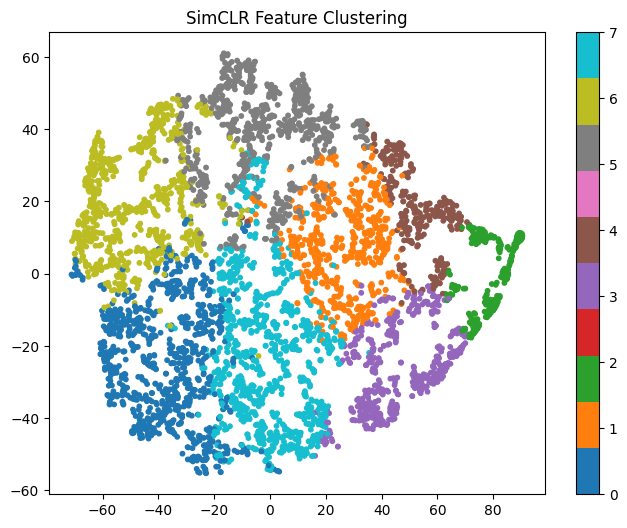

In [41]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt



# === CONFIG ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
num_clusters = 8  # Set this based on how many groups you expect

# === STEP 1: Extract Features ===
def extract_features(encoder, dataloader):
    encoder.eval()
    all_features = []
    with torch.no_grad():
        for x_i, _ in dataloader:
            x_i = x_i.to(device)
            feats = encoder(x_i)  # encoder returns shape [B, D]
            all_features.append(feats.cpu())
    return torch.cat(all_features, dim=0).numpy()  # shape: [N, D]


# === STEP 2: Dimensionality Reduction ===
def reduce_dimensionality(features, n_pca=50):
    features = features[~np.isnan(features).any(axis=1)]
    pca = PCA(n_components=n_pca)
    return pca.fit_transform(features)

# === STEP 3: KMeans Clustering ===
def cluster_features(features, num_clusters):
    kmeans = KMeans(n_clusters=num_clusters, random_state=0)
    cluster_ids = kmeans.fit_predict(features)
    return cluster_ids

# === STEP 4: Visualization with t-SNE ===
def visualize_clusters(features, cluster_ids, title="t-SNE Clustering"):
    tsne = TSNE(n_components=2, perplexity=30, random_state=0)
    embedded = tsne.fit_transform(features)
    plt.figure(figsize=(8, 6))
    plt.scatter(embedded[:, 0], embedded[:, 1], c=cluster_ids, cmap='tab10', s=10)
    plt.title(title)
    plt.colorbar()
    plt.show()

# === USAGE ===
features = extract_features(model.encoder, train_loader)

# Optional PCA before KMeans and t-SNE
reduced_features = reduce_dimensionality(features, n_pca=50)

# Clustering
cluster_ids = cluster_features(reduced_features, num_clusters)

# Visualize
visualize_clusters(reduced_features, cluster_ids, title="SimCLR Feature Clustering")


In [ ]:
#import umap.umap_ as umap

In [ ]:
#def visualize_clusters_umap(features, cluster_ids, title="UMAP Clustering"):
#    reducer = umap.UMAP(n_components=2, random_state=0)
#    embedded = reducer.fit_transform(features)
#    plt.figure(figsize=(8, 6))
#    plt.scatter(embedded[:, 0], embedded[:, 1], c=cluster_ids, cmap='tab10', s=10)
#    plt.title(title)
#    plt.colorbar()
#    plt.show()
     

In [ ]:
#Visualize with UMAP
#visualize_clusters_umap(reduced_features, cluster_ids, title="SimCLR Feature Clustering (UMAP)")


In [42]:

def show_images_from_cluster(dataset, cluster_ids, cluster_num, num_images=5, images_per_row=10):
    indices = np.where(cluster_ids == cluster_num)[0][:num_images]
    num_rows = (num_images + images_per_row - 1) // images_per_row

    plt.figure(figsize=(images_per_row * 2, num_rows * 2))  # Increase figure size

    for i, idx in enumerate(indices):
        img, _ = dataset[idx]
        plt.subplot(num_rows, images_per_row, i + 1)
        plt.imshow(img.squeeze(), cmap='gray')
        plt.axis('off')

    plt.suptitle(f"Images in Cluster {cluster_num}", fontsize=16)
    plt.tight_layout()
    plt.show()

#  Loop over all clusters
def show_all_clusters(dataset, cluster_ids, num_images=10):
    unique_clusters = np.unique(cluster_ids)
    for cluster_num in unique_clusters:
        show_images_from_cluster(dataset, cluster_ids, cluster_num, num_images=num_images)
     

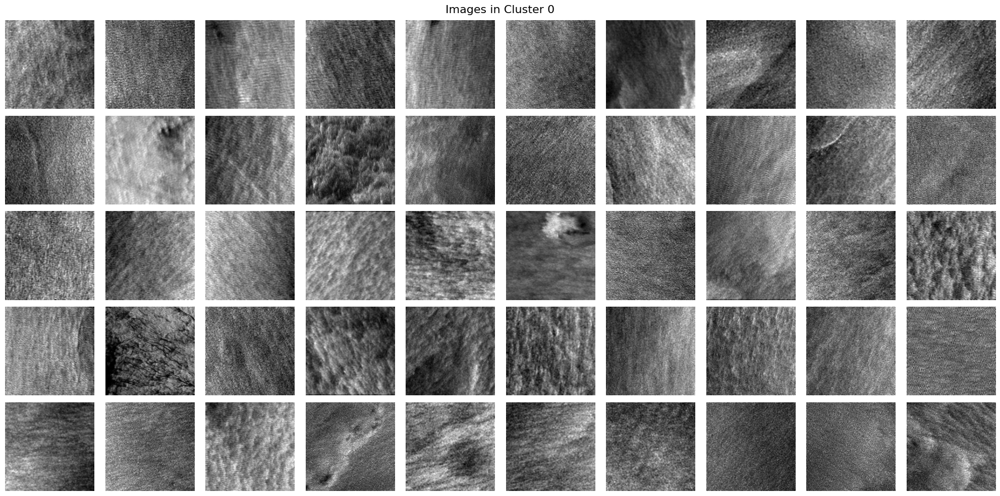

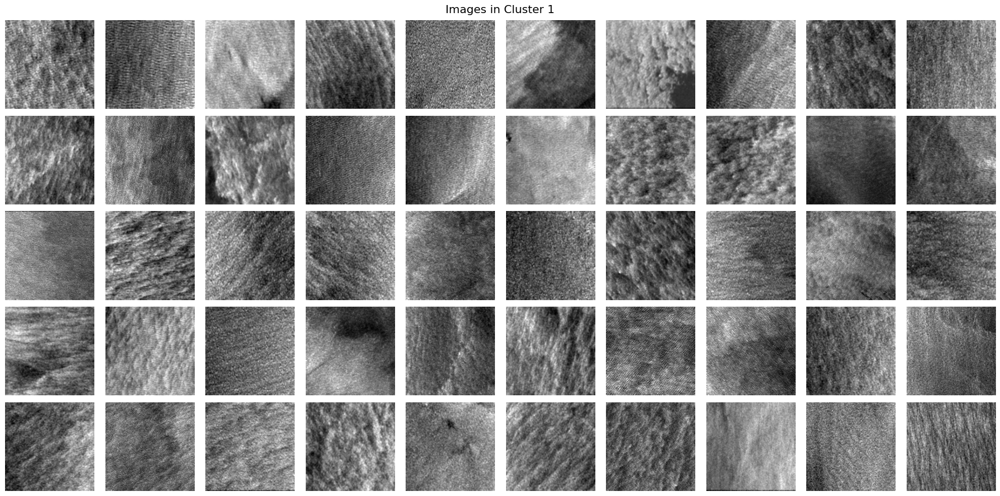

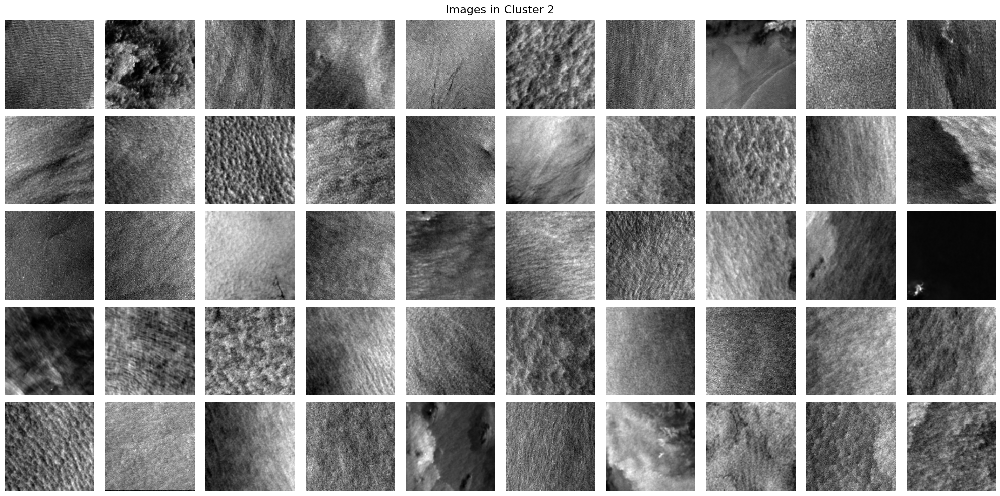

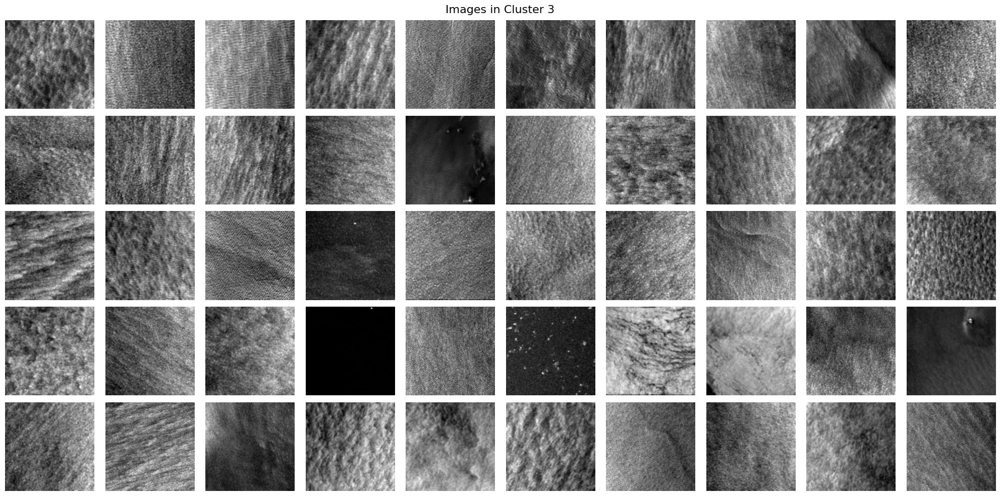

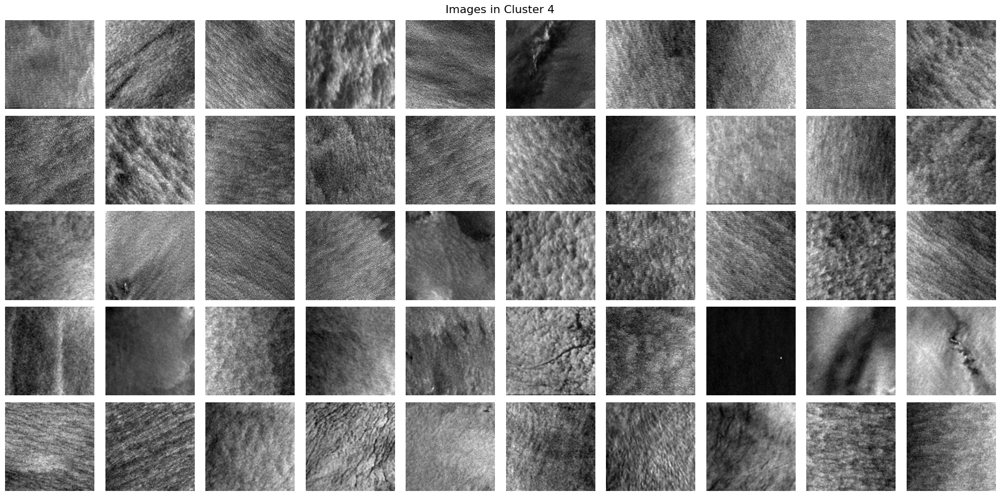

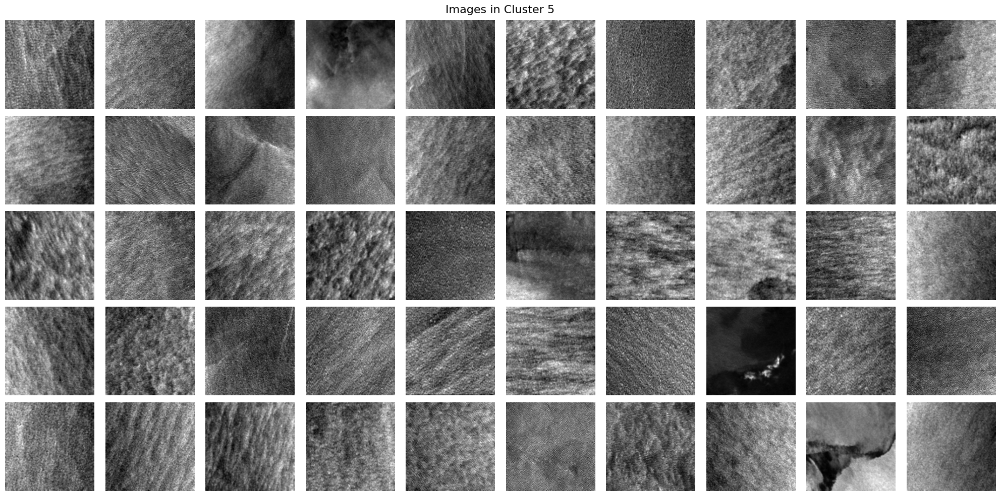

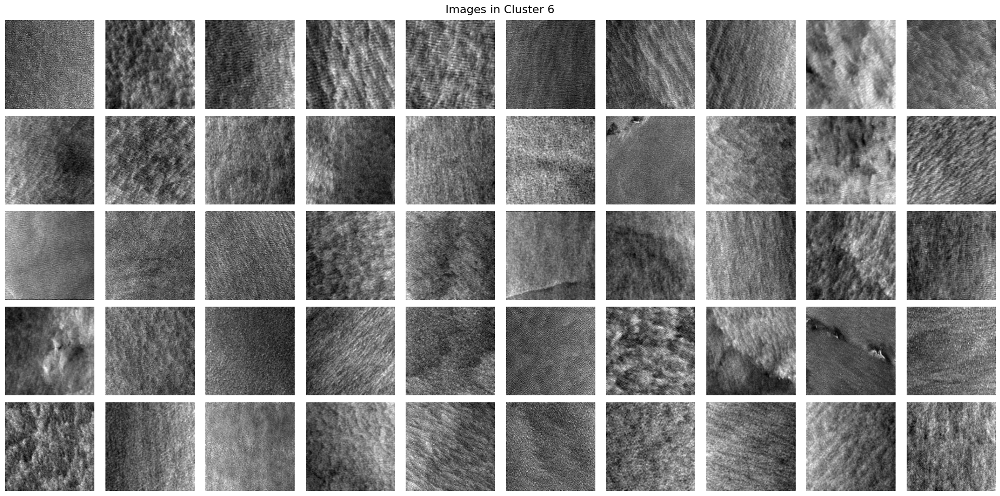

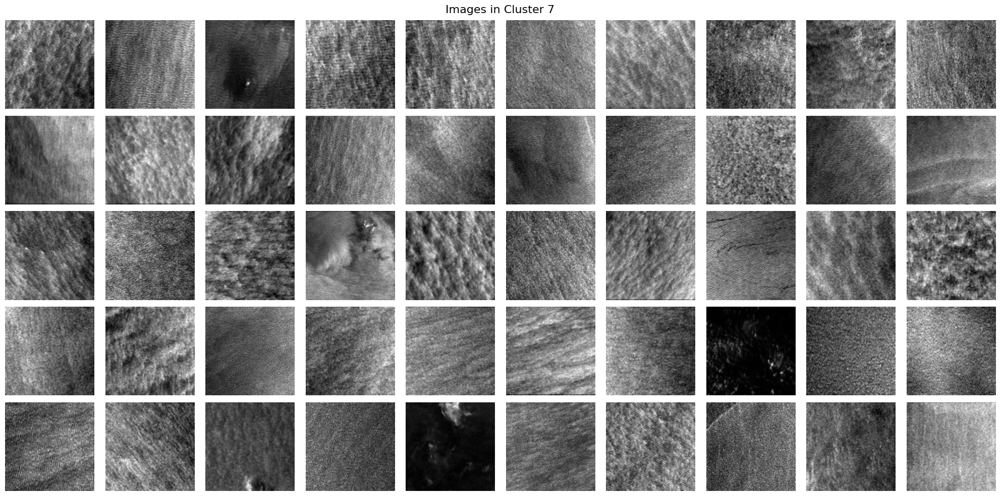

In [43]:
show_all_clusters(train_dataset, cluster_ids, num_images=50)

In [31]:
random_indices = np.random.choice(len(train_dataset), 50, replace=False)
random_images = [train_dataset[i][0] for i in random_indices]

In [22]:
def image_grid(images, num_rows=5, num_cols=10, cmap='gray'):
    plt.figure(figsize=(num_cols*2, num_rows*2))

    for i in range(num_rows*num_cols):
        ax = plt.subplot(num_rows, num_cols, i +1)
        ax.imshow(images[i].squeeze(), cmap=cmap)
        ax.axis('off')

    plt.tight_layout(pad=1.5)
    plt.show()

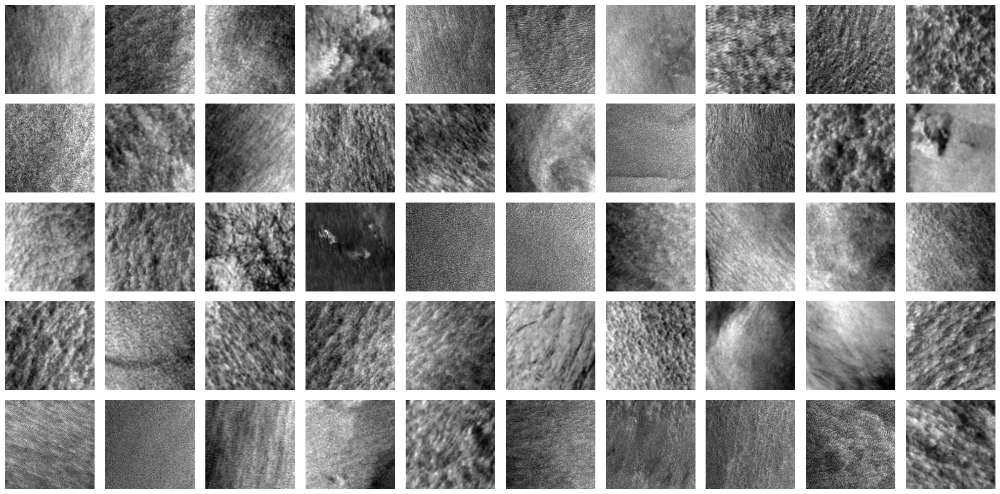

In [23]:
image_grid(random_images, num_rows=5, num_cols=10)

In [36]:
from sklearn.metrics.pairwise import cosine_similarity
import heapq

def find_most_similar_images(features, dataset, top_k=5):
    # Normalise features for cosine similarity
    norm_features = features / np.linalg.norm(features, axis=1, keepdims=True)

    # Compute cosine similarity matrix
    sim_matrix = cosine_similarity(norm_features)

    # To avoid self-matches, set diagonal to -1
    np.fill_diagonal(sim_matrix, -1)

    # For each image, find top_k most similar images
    most_similar_indices = []
    for i in range(len(sim_matrix)):
        top_k_idx = np.argsort(sim_matrix[i])[-top_k:]
        most_similar_indices.append((i, top_k_idx[::-1]))  # Reverse to get most similar first

    return most_similar_indices

In [37]:
def show_similar_images(dataset, most_similar_indices, num_examples=5):
    for i, (anchor_idx, similar_idxs) in enumerate(most_similar_indices[:num_examples]):
        plt.figure(figsize=(12, 2))
        img, _ = dataset[anchor_idx]
        plt.subplot(1, len(similar_idxs) + 1, 1)
        plt.imshow(img.squeeze(), cmap='gray')
        plt.title("Anchor")
        plt.axis('off')

        for j, idx in enumerate(similar_idxs):
            sim_img, _ = dataset[idx]
            plt.subplot(1, len(similar_idxs) + 1, j + 2)
            plt.imshow(sim_img.squeeze(), cmap='gray')
            plt.title(f"Top {j+1}")
            plt.axis('off')

        plt.suptitle(f"Most Similar to Image {anchor_idx}")
        plt.tight_layout()
        plt.show()

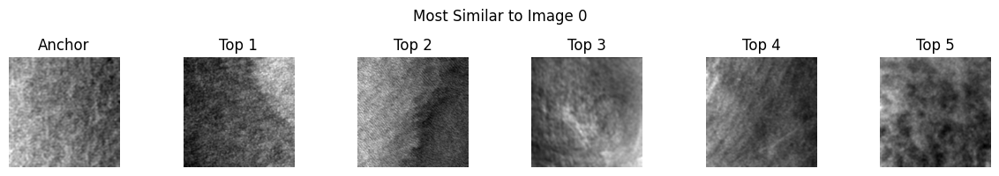

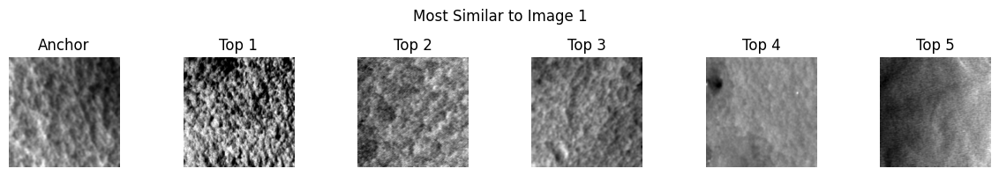

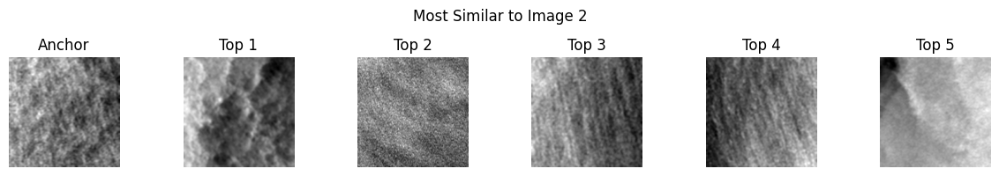

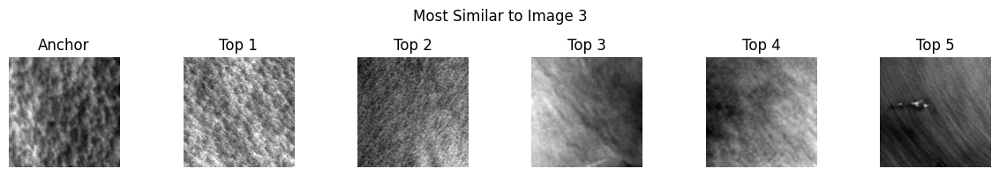

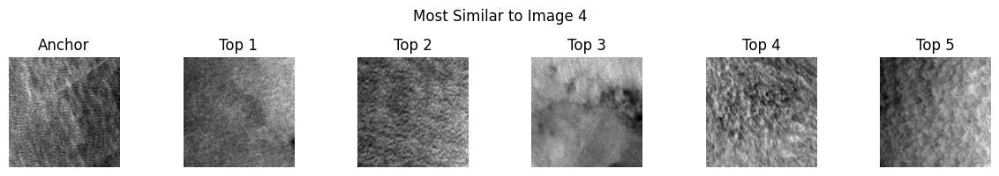

In [38]:
most_similar = find_most_similar_images(reduced_features, train_dataset, top_k=5)
show_similar_images(train_dataset, most_similar, num_examples=5)

In [ ]:
# Inspect first 4 batches from the DataLoader
#for batch_idx, data in enumerate(train_loader):
   print(f"\n--- Batch {batch_idx + 1} ---")

    if isinstance(data, (tuple, list)):
       inputs, labels = data
        print(f"Inputs shape: {inputs.shape}")
      print(f"Labels shape: {labels.shape}")
        # Print sample data from the batch
        for i in range(min(3, len(inputs))):  # limit output to first 3 items per batch
            print(f"\nSample {i}:")
            print("Input tensor:")
            print(inputs[i])
            print("Label:")
            print(labels[i])
    else:
        print(f"Shape of data: {data.shape}")
        print("Data values:")
        print(data)

    if batch_idx >= 1:
        break  # Only process the first 4 batches


In [46]:
class ContrastiveAugA:
    def __init__(self):
        self.transform = T.Compose([
            T.RandomResizedCrop(190, scale=(0.5, 1.0)),
            T.RandomHorizontalFlip(),
        ])

    def __call__(self, x):
        return self.transform(x), self.transform(x)

class ContrastiveAugB:
    def __init__(self):
        self.transform = T.Compose([
            T.RandomResizedCrop(190, scale=(0.7, 1.0)),
            T.RandomVerticalFlip(),
            T.GaussianBlur(3),
        ])

    def __call__(self, x):
        return self.transform(x), self.transform(x)

class ContrastiveAugC:
    def __init__(self):
        self.transform = T.Compose([
            T.RandomAffine(degrees=15, translate=(0.05, 0.05)),
        ])

    def __call__(self, x):
        return self.transform(x), self.transform(x)

In [ ]:
def get_fresh_model():
    base_encoder = simple_cnn()
    model = SimCLR(base_encoder)
    return model

In [ ]:
def get_fresh_model():
    base_encoder = simple_cnn()
    model = SimCLR(base_encoder)
    return model

In [ ]:
def get_fresh_model():
    base_encoder = simple_cnn()
    model = SimCLR(base_encoder)
    return model

In [47]:
def get_fresh_model():
    base_encoder = simple_cnn()
    model = SimCLR(base_encoder)
    return model

In [48]:
def train_contrastive(model, dataloader, optimizer, epochs=10):
    model.train()
    loss_history = []

    for epoch in range(epochs):
        total_loss = 0
        for x_i, x_j in dataloader:
            x_i, x_j = x_i.to(device), x_j.to(device)
            z_i = model(x_i)
            z_j = model(x_j)

            if torch.isnan(z_i).any() or torch.isnan(z_j).any():
                continue

            loss = nt_xent_loss(z_i, z_j, temperature=0.4)
            if torch.isnan(loss):
                continue

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_loss += loss.item()

        avg_loss = total_loss / len(dataloader)
        loss_history.append(avg_loss)
        print(f"Epoch [{epoch+1}/{epochs}] | Loss: {avg_loss:.4f}")
    
    return loss_history


🔁 Training with AugA...

Epoch [1/10] | Loss: 3.0781
Epoch [2/10] | Loss: 2.8462
Epoch [3/10] | Loss: 2.7966
Epoch [4/10] | Loss: 2.7624
Epoch [5/10] | Loss: 2.7562
Epoch [6/10] | Loss: 2.7514
Epoch [7/10] | Loss: 2.7270
Epoch [8/10] | Loss: 2.7178
Epoch [9/10] | Loss: 2.6936
Epoch [10/10] | Loss: 2.6875

🔁 Training with AugB...

Epoch [1/10] | Loss: 3.0540
Epoch [2/10] | Loss: 2.7923
Epoch [3/10] | Loss: 2.7429
Epoch [4/10] | Loss: 2.7268
Epoch [5/10] | Loss: 2.6979
Epoch [6/10] | Loss: 2.6868
Epoch [7/10] | Loss: 2.6753
Epoch [8/10] | Loss: 2.6592
Epoch [9/10] | Loss: 2.6620
Epoch [10/10] | Loss: 2.6488

🔁 Training with AugC...

Epoch [1/10] | Loss: 2.7528
Epoch [2/10] | Loss: 2.5899
Epoch [3/10] | Loss: 2.5649
Epoch [4/10] | Loss: 2.5555
Epoch [5/10] | Loss: 2.5434
Epoch [6/10] | Loss: 2.5372
Epoch [7/10] | Loss: 2.5367
Epoch [8/10] | Loss: 2.5278
Epoch [9/10] | Loss: 2.5176
Epoch [10/10] | Loss: 2.5223


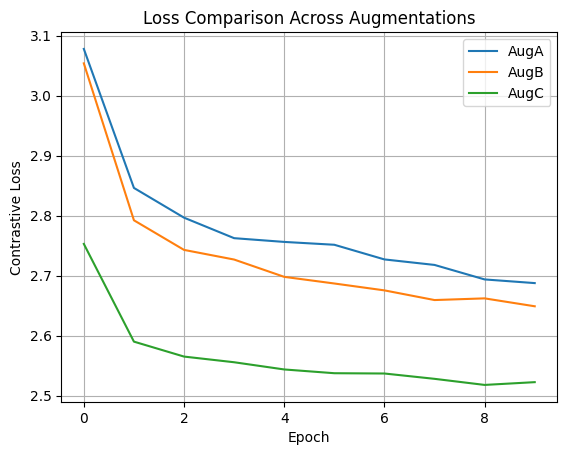

In [49]:
augmentations = {
    'AugA': ContrastiveAugA,
    'AugB': ContrastiveAugB,
    'AugC': ContrastiveAugC,
}

loss_curves = {}
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for name, AugClass in augmentations.items():
    print(f"\n Training with {name}...\n")
    dataset = InMemoryContrastiveDataset(sigma0_stack, transform=AugClass())
    dataloader = DataLoader(dataset, batch_size=64, shuffle=True)

    model = get_fresh_model().to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

    loss_history = train_contrastive(model, dataloader, optimizer, epochs=10)
    loss_curves[name] = loss_history

# === STEP 6: Plot loss curves ===
for name, losses in loss_curves.items():
    plt.plot(losses, label=name)
plt.xlabel("Epoch")
plt.ylabel("Contrastive Loss")
plt.title("Loss Comparison Across Augmentations")
plt.legend()
plt.grid()
plt.show()

In [50]:
class ContrastiveAugD:
    def __init__(self):
        self.transform = T.Compose([
            T.RandomResizedCrop(190, scale=(0.3, 1.0)),  # Stronger crop
            T.RandomHorizontalFlip(),
            T.RandomVerticalFlip(),
            T.Lambda(lambda x: x + 0.1 * torch.randn_like(x)),  # Add Gaussian noise
        ])

    def __call__(self, x):
        return self.transform(x), self.transform(x)

class ContrastiveAugE:
    def __init__(self):
        self.transform = T.Compose([
            T.RandomRotation(degrees=45),
            T.RandomResizedCrop(190, scale=(0.8, 1.0)),
            T.GaussianBlur(kernel_size=5, sigma=(0.5, 1.5)),
        ])

    def __call__(self, x):
        return self.transform(x), self.transform(x)


class ContrastiveAugF:
    def __init__(self):
        self.transform = T.Compose([
            T.RandomPerspective(distortion_scale=0.5, p=0.7),
            T.RandomAffine(degrees=30, scale=(0.8, 1.2), shear=10),
            T.RandomResizedCrop(190, scale=(0.6, 1.0)),
            T.RandomHorizontalFlip(),
        ])

    def __call__(self, x):
        return self.transform(x), self.transform(x)

class ContrastiveAugG:
    def __init__(self):
        self.transform = T.Compose([
            T.RandomResizedCrop(190, scale=(0.7, 1.0)),
            T.RandomApply([T.GaussianBlur(kernel_size=5)], p=0.5),
            T.Lambda(lambda x: x + 0.05 * torch.randn_like(x))  # Add structured noise
        ])

    def __call__(self, x):
        return self.transform(x), self.transform(x)

class ContrastiveAugG:
    def __init__(self):
        self.transform = T.Compose([
            T.RandomResizedCrop(190, scale=(0.7, 1.0)),
            T.RandomApply([T.GaussianBlur(kernel_size=5)], p=0.5),
            T.Lambda(lambda x: x + 0.05 * torch.randn_like(x))  # Add structured noise
        ])

    def __call__(self, x):
        return self.transform(x), self.transform(x)

class ContrastiveAugH:
    def __init__(self):
        self.transform = T.Compose([
            T.RandomResizedCrop(190, scale=(0.6, 1.0)),
            T.RandomHorizontalFlip(),
            T.RandomApply([T.RandomErasing(p=1.0, scale=(0.02, 0.15))], p=0.7),
        ])

    def __call__(self, x):
        return self.transform(x), self.transform(x)



 Training with AugD...

Epoch [1/10] | Loss: 2.5391
Epoch [2/10] | Loss: 2.3199
Epoch [3/10] | Loss: 2.2808
Epoch [4/10] | Loss: 2.2534
Epoch [5/10] | Loss: 2.2420
Epoch [6/10] | Loss: 2.2262
Epoch [7/10] | Loss: 2.2123
Epoch [8/10] | Loss: 2.2013
Epoch [9/10] | Loss: 2.1862
Epoch [10/10] | Loss: 2.1796

 Training with AudE...

Epoch [1/10] | Loss: 2.2433
Epoch [2/10] | Loss: 2.0988
Epoch [3/10] | Loss: 2.0673
Epoch [4/10] | Loss: 2.0516
Epoch [5/10] | Loss: 2.0349
Epoch [6/10] | Loss: 2.0302
Epoch [7/10] | Loss: 2.0178
Epoch [8/10] | Loss: 2.0011
Epoch [9/10] | Loss: 1.9972
Epoch [10/10] | Loss: 1.9916

 Training with AugF...

Epoch [1/10] | Loss: 2.6098
Epoch [2/10] | Loss: 2.3634
Epoch [3/10] | Loss: 2.2956
Epoch [4/10] | Loss: 2.2672
Epoch [5/10] | Loss: 2.2475
Epoch [6/10] | Loss: 2.2304
Epoch [7/10] | Loss: 2.2047
Epoch [8/10] | Loss: 2.1859
Epoch [9/10] | Loss: 2.1885
Epoch [10/10] | Loss: 2.1820

 Training with AugG...

Epoch [1/10] | Loss: 2.3471
Epoch [2/10] | Loss: 2.1654
E

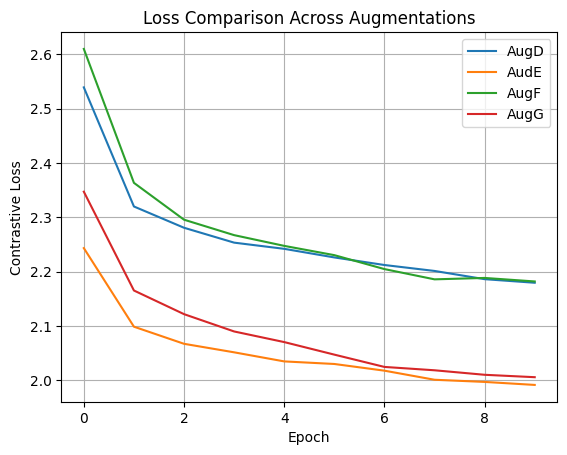

In [58]:
augmentations = {
    'AugD': ContrastiveAugD,
    'AudE': ContrastiveAugE,
    'AugF': ContrastiveAugF,
    'AugG': ContrastiveAugG
}

loss_curves = {}
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for name, AugClass in augmentations.items():
    print(f"\n Training with {name}...\n")
    dataset = InMemoryContrastiveDataset(sigma0_stack, transform=AugClass())
    dataloader = DataLoader(dataset, batch_size=32, shuffle=True)

    model = get_fresh_model().to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

    loss_history = train_contrastive(model, dataloader, optimizer, epochs=10)
    loss_curves[name] = loss_history

# === STEP 6: Plot loss curves ===
for name, losses in loss_curves.items():
    plt.plot(losses, label=name)
plt.xlabel("Epoch")
plt.ylabel("Contrastive Loss")
plt.title("Loss Comparison Across Augmentations")
plt.legend()
plt.grid()
plt.show()

In [57]:

augmentations = {
    'AugH': ContrastiveAugH
}

loss_curves = {}
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for name, AugClass in augmentations.items():
    print(f"\n Training with {name}...\n")
    dataset = InMemoryContrastiveDataset(sigma0_stack, transform=AugClass())
    dataloader = DataLoader(dataset, batch_size=32, shuffle=True)

    model = get_fresh_model().to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

    loss_history = train_contrastive(model, dataloader, optimizer, epochs=10)
    loss_curves[name] = loss_history

# === STEP 6: Plot loss curves ===
for name, losses in loss_curves.items():
    plt.plot(losses, label=name)
plt.xlabel("Epoch")
plt.ylabel("Contrastive Loss")
plt.title("Loss Comparison Across Augmentations")
plt.legend()
plt.grid()
plt.show()

In [59]:
class DualViewTransform:
    def __init__(self):
        self.weak_transform = T.Compose([
            T.RandomResizedCrop(190, scale=(0.8, 1.0)),
            T.RandomHorizontalFlip(),
        ])

        self.strong_transform = T.Compose([
            T.RandomResizedCrop(190, scale=(0.4, 1.0)),
            T.RandomRotation(90),
            T.RandomApply([T.GaussianBlur(7, sigma=(1.0, 2.0))], p=0.9),
            T.RandomApply([T.RandomAffine(degrees=30, translate=(0.1, 0.1), scale=(0.8, 1.2), shear=10)], p=0.7),
            T.RandomApply([T.RandomErasing(p=1.0, scale=(0.05, 0.3))], p=0.9),
            T.Lambda(lambda x: x + 0.1 * torch.randn_like(x)),  # More aggressive noise
        ])

    def __call__(self, x):
        return self.weak_transform(x), self.strong_transform(x)

In [60]:
def train_contrastive(model, dataloader, optimizer, epochs=15):
    model.train()
    loss_history = []

    for epoch in range(epochs):
        total_loss = 0
        for x_weak, x_strong in dataloader:
            x_weak, x_strong = x_weak.to(device), x_strong.to(device)
            z_weak = model(x_weak)
            z_strong = model(x_strong)

            loss = nt_xent_loss(z_weak, z_strong, temperature=0.4)
            if torch.isnan(loss):
                continue

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            total_loss += loss.item()

        avg_loss = total_loss / len(dataloader)
        loss_history.append(avg_loss)
        print(f"Epoch [{epoch+1}/{epochs}] | Loss: {avg_loss:.4f}")
    return loss_history

Epoch [1/10] | Loss: 2.9957
Epoch [2/10] | Loss: 2.7378
Epoch [3/10] | Loss: 2.5825
Epoch [4/10] | Loss: 2.5027
Epoch [5/10] | Loss: 2.4521
Epoch [6/10] | Loss: 2.4177
Epoch [7/10] | Loss: 2.4040
Epoch [8/10] | Loss: 2.3807
Epoch [9/10] | Loss: 2.3629
Epoch [10/10] | Loss: 2.3501


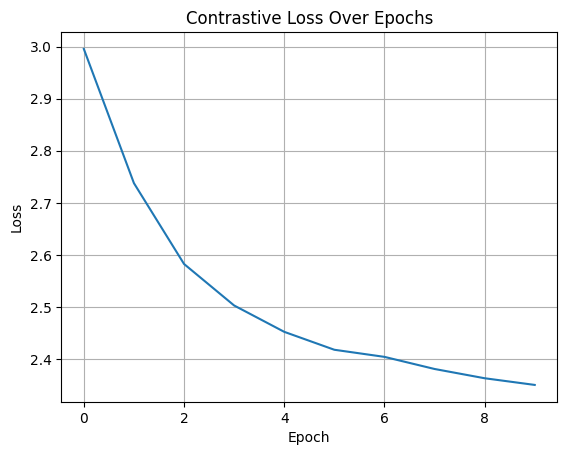

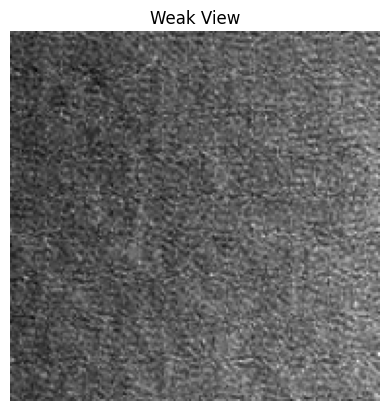

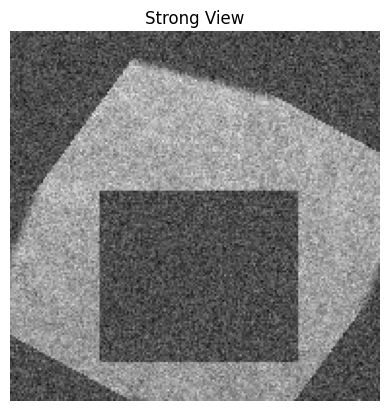

In [62]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

transform = DualViewTransform()
dataset = InMemoryContrastiveDataset(sigma0_stack, transform=transform)
train_loader = DataLoader(dataset, batch_size=32, shuffle=True)

model = SimCLR(simple_cnn()).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

losses = train_contrastive(model, train_loader, optimizer, epochs=10)

# ----- STEP 7: Optional Visualization -----

plt.plot(losses)
plt.title("Contrastive Loss Over Epochs")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.grid()
plt.show()

# ----- Visualize a Pair of Augmentations -----
x1, x2 = dataset[0]
plt.imshow(x1.squeeze(), cmap='gray')
plt.title("Weak View")
plt.axis('off')
plt.show()

plt.imshow(x2.squeeze(), cmap='gray')
plt.title("Strong View")
plt.axis('off')
plt.show()

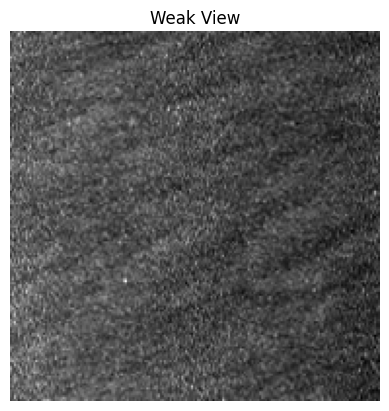

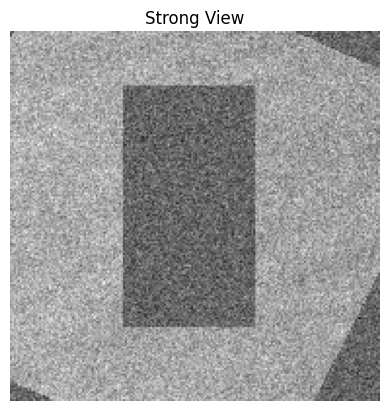

In [64]:
x1, x2 = dataset[210]
plt.imshow(x1.squeeze(), cmap='gray')
plt.title("Weak View")
plt.axis('off')
plt.show()

plt.imshow(x2.squeeze(), cmap='gray')
plt.title("Strong View")
plt.axis('off')
plt.show()

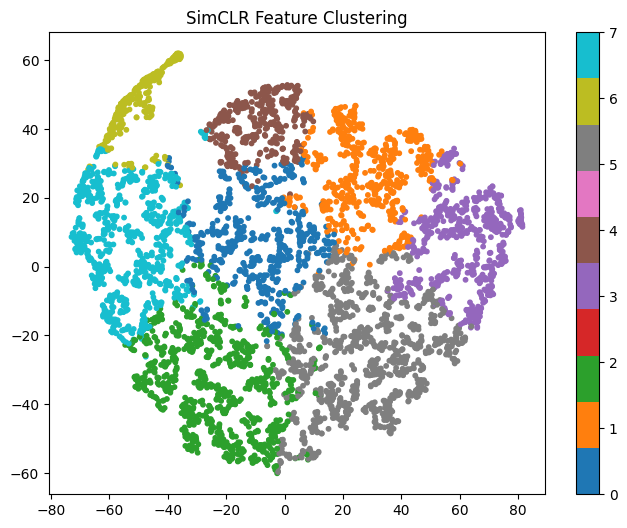

In [65]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt



# === CONFIG ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
num_clusters = 8  # Set this based on how many groups you expect

# === STEP 1: Extract Features ===
def extract_features(encoder, dataloader):
    encoder.eval()
    all_features = []
    with torch.no_grad():
        for x_i, _ in dataloader:
            x_i = x_i.to(device)
            feats = encoder(x_i)  # encoder returns shape [B, D]
            all_features.append(feats.cpu())
    return torch.cat(all_features, dim=0).numpy()  # shape: [N, D]


# === STEP 2: Dimensionality Reduction ===
def reduce_dimensionality(features, n_pca=50):
    features = features[~np.isnan(features).any(axis=1)]
    pca = PCA(n_components=n_pca)
    return pca.fit_transform(features)

# === STEP 3: KMeans Clustering ===
def cluster_features(features, num_clusters):
    kmeans = KMeans(n_clusters=num_clusters, random_state=0)
    cluster_ids = kmeans.fit_predict(features)
    return cluster_ids

# === STEP 4: Visualization with t-SNE ===
def visualize_clusters(features, cluster_ids, title="t-SNE Clustering"):
    tsne = TSNE(n_components=2, perplexity=30, random_state=0)
    embedded = tsne.fit_transform(features)
    plt.figure(figsize=(8, 6))
    plt.scatter(embedded[:, 0], embedded[:, 1], c=cluster_ids, cmap='tab10', s=10)
    plt.title(title)
    plt.colorbar()
    plt.show()

# === USAGE ===
features = extract_features(model.encoder, train_loader)

# Optional PCA before KMeans and t-SNE
reduced_features = reduce_dimensionality(features, n_pca=50)

# Clustering
cluster_ids = cluster_features(reduced_features, num_clusters)

# Visualize
visualize_clusters(reduced_features, cluster_ids, title="SimCLR Feature Clustering")


In [66]:

def show_images_from_cluster(dataset, cluster_ids, cluster_num, num_images=5, images_per_row=10):
    indices = np.where(cluster_ids == cluster_num)[0][:num_images]
    num_rows = (num_images + images_per_row - 1) // images_per_row

    plt.figure(figsize=(images_per_row * 2, num_rows * 2))  # Increase figure size

    for i, idx in enumerate(indices):
        img, _ = dataset[idx]
        plt.subplot(num_rows, images_per_row, i + 1)
        plt.imshow(img.squeeze(), cmap='gray')
        plt.axis('off')

    plt.suptitle(f"Images in Cluster {cluster_num}", fontsize=16)
    plt.tight_layout()
    plt.show()

#  Loop over all clusters
def show_all_clusters(dataset, cluster_ids, num_images=10):
    unique_clusters = np.unique(cluster_ids)
    for cluster_num in unique_clusters:
        show_images_from_cluster(dataset, cluster_ids, cluster_num, num_images=num_images)

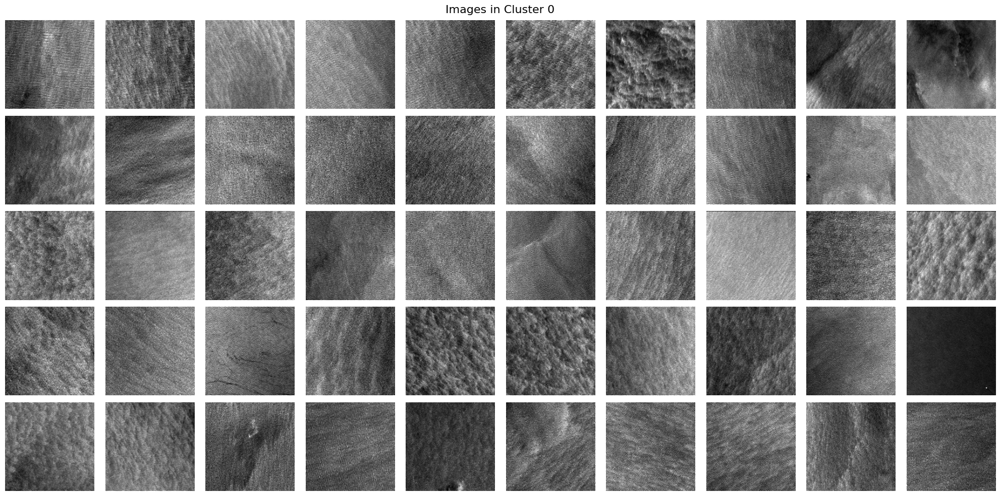

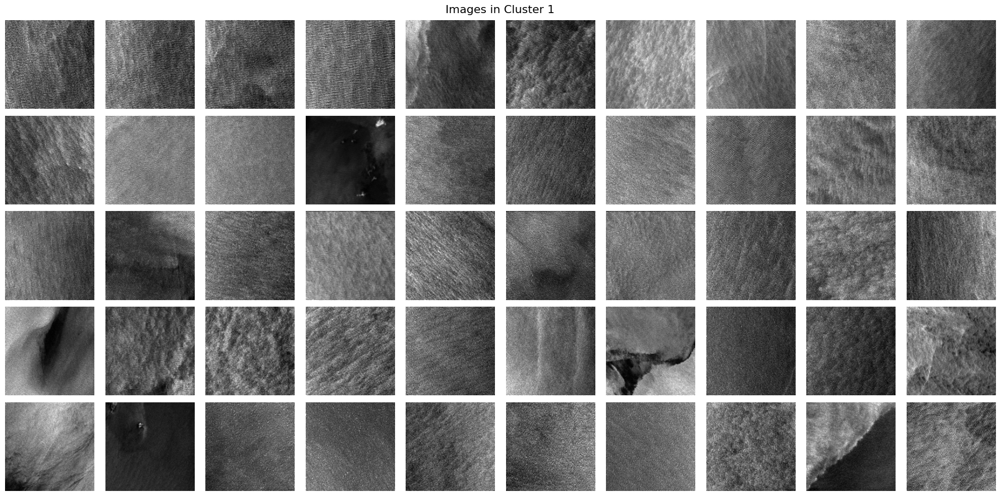

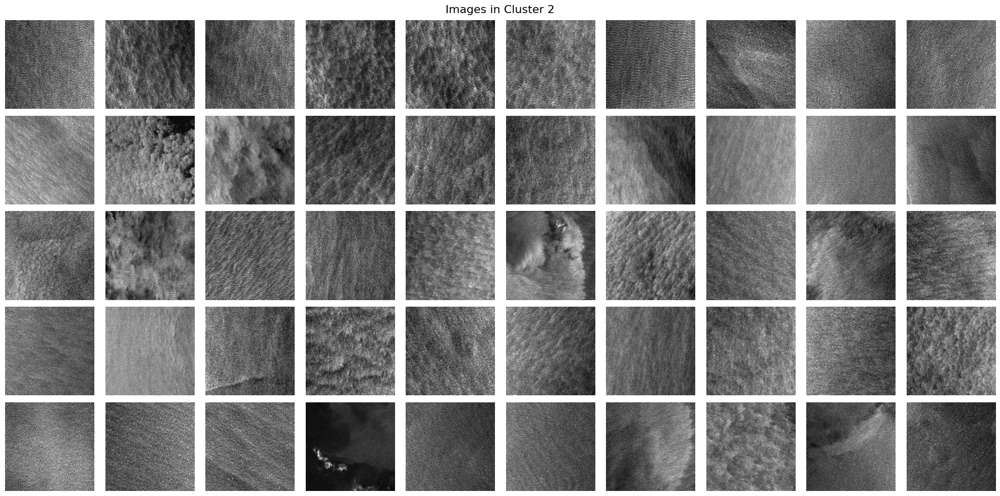

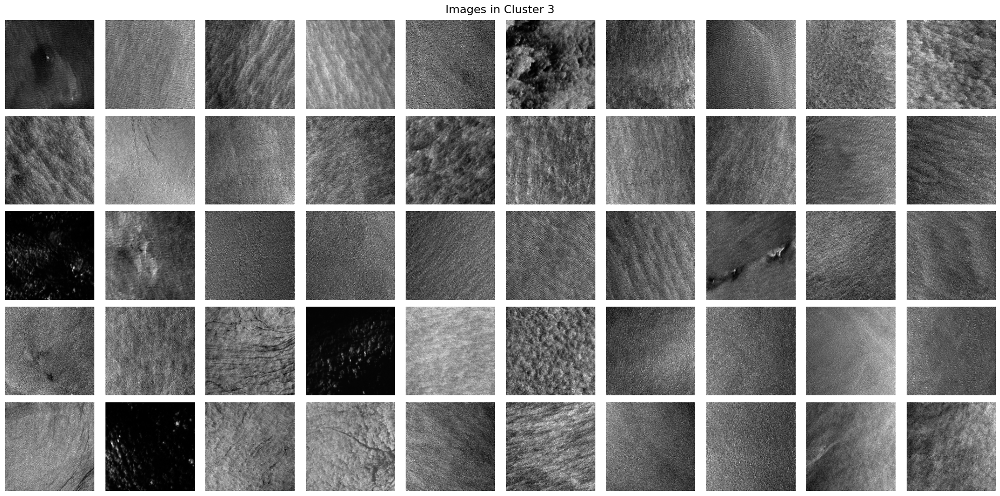

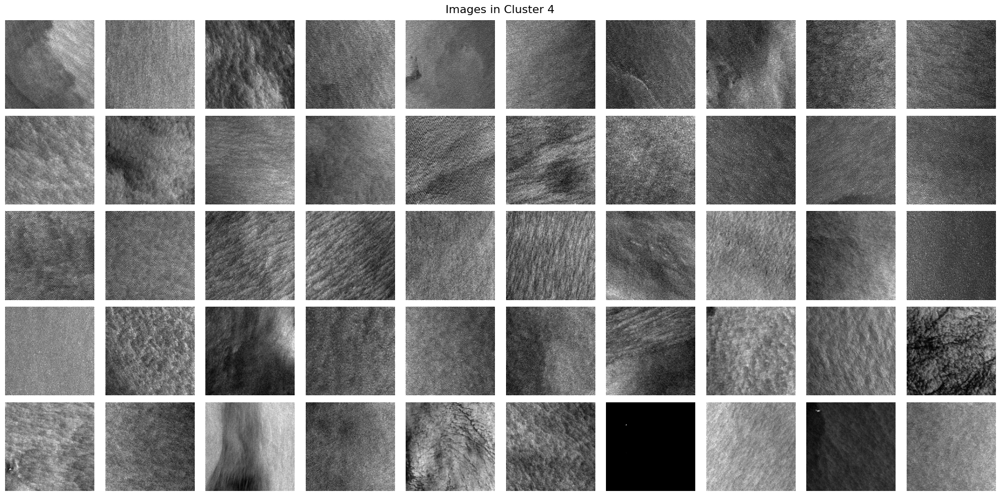

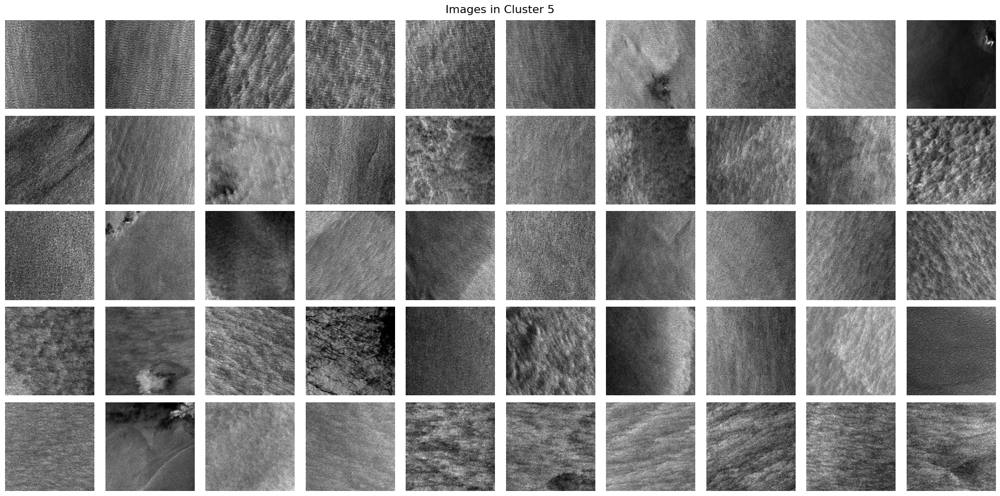

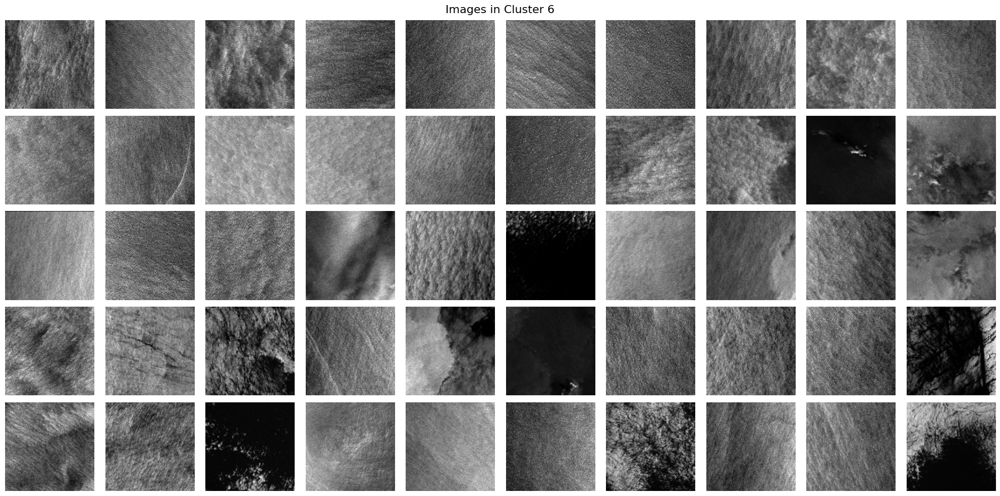

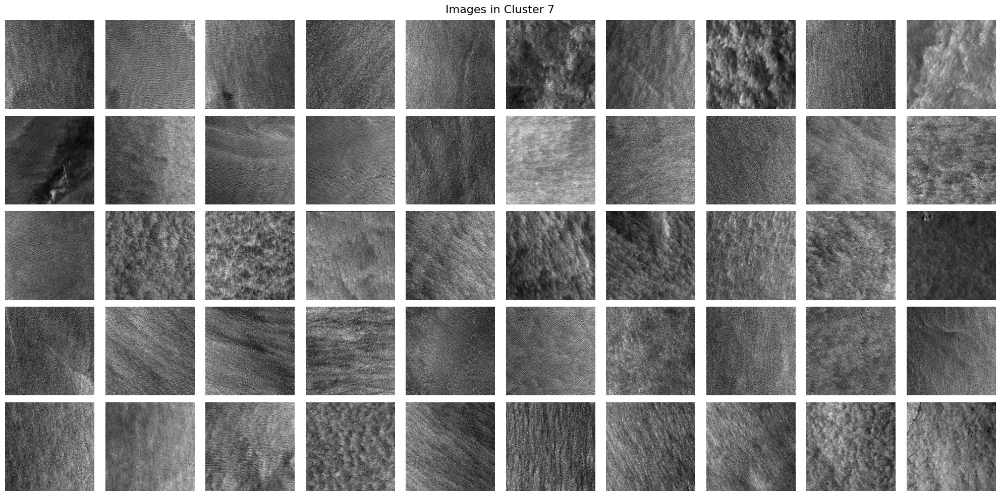

In [69]:
show_all_clusters(dataset, cluster_ids, 50)